<a href="https://colab.research.google.com/github/as14680/MOT-Assignment/blob/main/MOT_as14680.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Name: Akshat Sharma

Net ID: as14680

Importing all the important libraries for creating the environment and the agent system

The system takes around 20 mins to run and execute so be patient.

In [1]:
!pip3 install tensorflow-gpu==1.14.0
!pip3 install numpy
!pip3 install tensorflow==2.2.0
!pip3 install scipy


!pip3 install opencv-python
!pip3 install pillow
!pip3 install matplotlib
!pip3 install h5py



!pip3 install keras==2.2.4
!pip3 install imageai --upgrade
import numpy as np

  Using cached tensorboard-1.14.0-py3-none-any.whl (3.1 MB)
  Using cached tensorflow_estimator-1.14.0-py2.py3-none-any.whl (488 kB)
  Attempting uninstall: tensorflow-estimator
    Found existing installation: tensorflow-estimator 2.2.0
    Uninstalling tensorflow-estimator-2.2.0:
      Successfully uninstalled tensorflow-estimator-2.2.0
  Attempting uninstall: tensorboard
    Found existing installation: tensorboard 2.2.2
    Uninstalling tensorboard-2.2.2:
      Successfully uninstalled tensorboard-2.2.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.2.0 requires tensorboard<2.3.0,>=2.2.0, but you have tensorboard 1.14.0 which is incompatible.
tensorflow 2.2.0 requires tensorflow-estimator<2.3.0,>=2.2.0, but you have tensorflow-estimator 1.14.0 which is incompatible.
  Using cached tensorboard-2.2.2-py3-none-any.whl (3.0 MB)
  Using cached tens

Importing CV2 Framework, Kalman Filter, Tensor Flow and object detection for indepth analysis. As we want to implement an object detection in an easy and quick way, we will use a pretrained model specific for object detection that has been trained on YOLOv3 dataset.

In [2]:
import cv2
from cv2 import KalmanFilter
import tensorflow.keras


from imageai.Detection import ObjectDetection
import os


from google.colab.patches import cv2_imshow
import tensorflow as tf

Mostly in 2D kalman filter we assume the followings:

The function __init__() is mostly used to initialize the class parameters. 

It has six input variable namely dt, u_x, u_y, std_acc, x_std_meas and y_std_meas. The dt is the sampling time or the time for 1 cycle which is used to estimate the state, u_x and u_y are the acceleration in the x– and y-directions, respectively. The std_acc is the process noise magnitude, x_std_meas and x_std_meas are the standard deviations of the measurement in the x– and y-directions, concurrently.

The functionpredict() does the prediction of the state estimate \textbf {\^{x}}^{-}_k and the error covariance \textbf {P}^{-}_k

During the update stage, we compute the Kalman gain  \textbf {K}_k, then update the predicted state estimate  \textbf {\^{x}}_k and predicted error covariance  \textbf {P}_k




In [3]:
class KalmanFilter(object):
      def __init__(self, dt, u_x,u_y, std_acc, x_std_meas, y_std_meas):
          #define sampling
          self.dt=dt
          #define control variables
          self.u=np.matrix([[u_x],[u_y]])
          #Initial State
          self.x=np.matrix([[0],[0],[0],[0]])
          #define the state transition matrix A
          self.A=np.matrix([[1,0,self.dt,0],
                           [0,1,0,self.dt],
                           [0,0,1,0],
                           [0,0,0,1]])
          #define the control input matrix B
          self.B=np.matrix([[(self.dt**2)/2,0],
                           [0,(self.dt**2)/2],
                           [self.dt,0],
                           [0,self.dt]])
          #define measurement mapping matrix
          self.H=np.matrix([[1,0,0,0],
                           [0,1,0,0]])
          #Initial noise variance matrix
          self.Q=np.matrix([[(self.dt**4)/4,0,(self.dt**3)/2,0],
                           [0,(self.dt**4)/4,0,(self.dt**3)/2],
                           [(self.dt**3)/2,0,(self.dt**2),0],
                           [(self.dt**4)/2,0,(self.dt**3)/2,0]])* std_acc**2
          #initial measurement noise covariance 
          self.R=np.matrix([[x_std_meas**2,0],
                            [0,y_std_meas**2]])
          #Initial Covarinace Matrix
          self.P=np.eye(self.A.shape[1])

      def predict(self):
          self.x=np.dot(self.A,self.x)+np.dot(self.B,self.u)
          self.P=np.dot(np.dot(self.A,self.P),self.A.T)+self.Q
          return self.x[0:2]
      def update(self,z):
          s=np.dot(self.H,np.dot(self.P,self.H.T))+self.R
          K=np.dot(np.dot(self.P,self.H.T),np.linalg.inv(s))
          self.x=np.round(self.x+np.dot(K,(z-np.dot(self.H,self.x))))
          I=np.eye(self.H.shape[1])
          #update error covarriance matrix
          self.P= (I-(K*self.H))*self.P
          return self.x[0:2]

Next, we can start to load the model by first specifying the path to our model. Since our model is in the same directory as our Python script, here I will to load the YOLOv3 model.

Finally, we can start to create an image object detection system. To do this, we need to specify two things: First, the directory and the filename of our input image and second, the directory and the filename of the output image


In order to reduce the clutter in the prediction result, you can tune the object detector such that it only shows the object that really matters for you.


Next, we can start to build the object detection system with detectCustomObjectsFromImage method. We pass our custom variable, the path and name of our input image, as well as the path and name of our output image.

Moreover, we can also further remove the clutter by ignoring the predictions that have probability values below a certain threshold value. Let’s say that you want to ignore the predictions with probability value below 70%. You can do that by adding the minimum_percentage_probability argument in the detectCustomObjectsFromImage method.



MOT ran with alot of imperfection but could have been improved over time

Loading Model in a bit


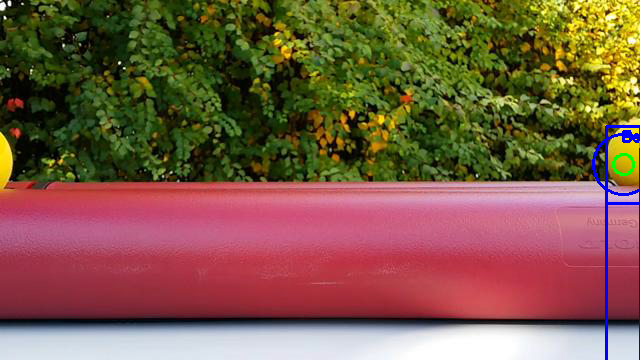

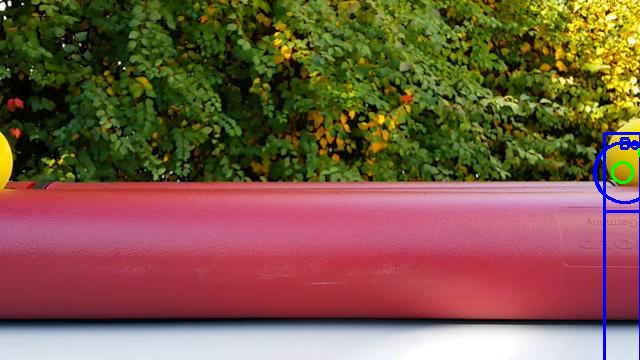

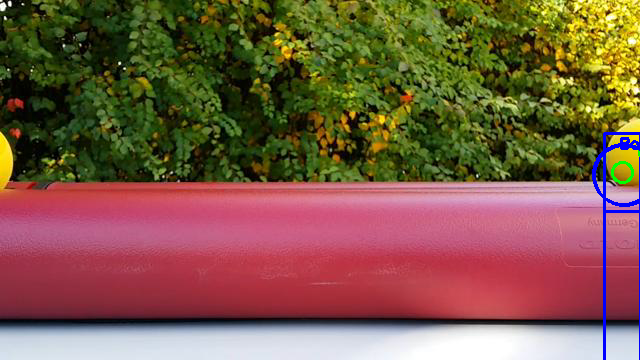

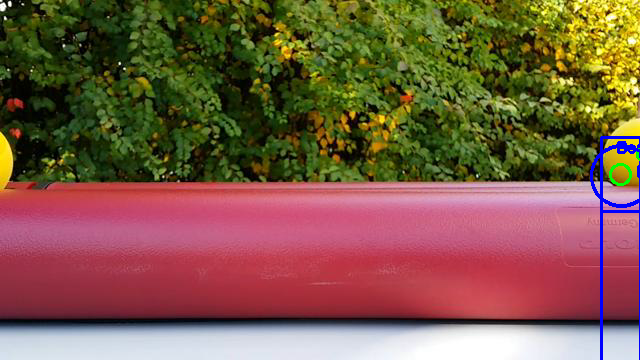

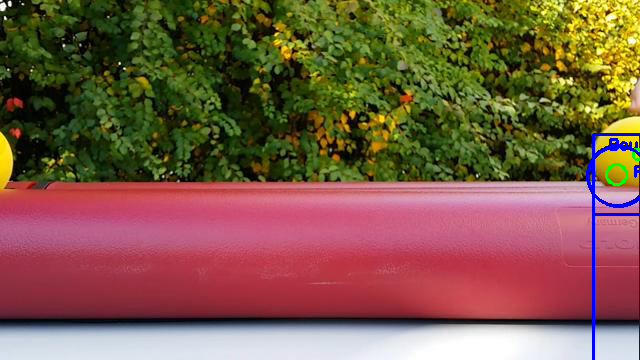

...

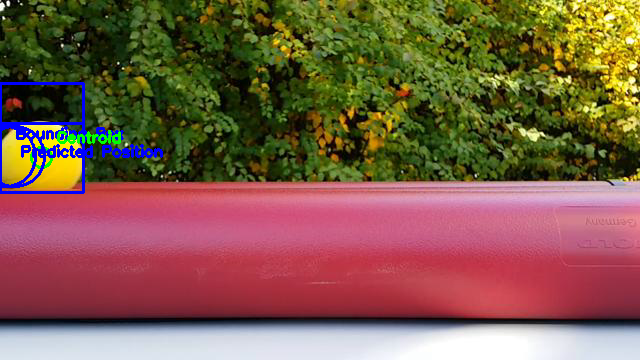

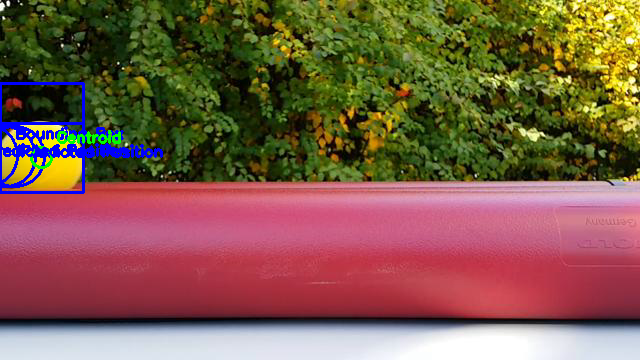

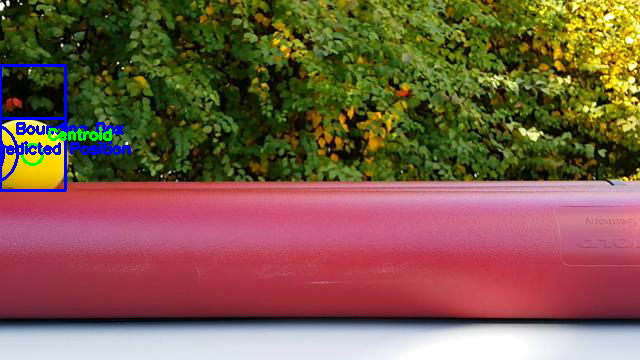

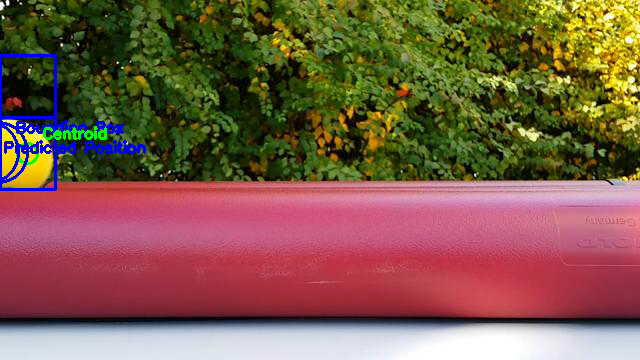

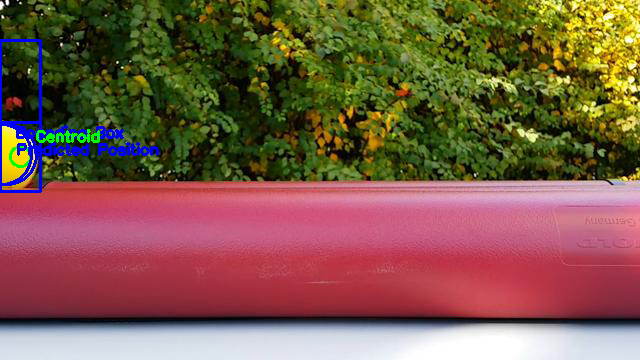

In [4]:
import numpy as np
import os
KF1= KalmanFilter(0.1,1,1,1,0.1,0.1)
KF2= KalmanFilter(0.1,1,1,1,0.1,0.1)
color=(255,0,0)
thickness = 2
img_array = []
current_directory=os.getcwd()
detector= ObjectDetection()
detector.setModelTypeAsYOLOv3()

detector.setModelPath('/content/drive/MyDrive/MOT_Assign/yolo.h5')

detector.loadModel()
print('Loading Model in a bit')

vidcap=cv2.VideoCapture('/content/drive/MyDrive/MOT_Assign/objectTracking_examples_multiObject.avi')
success,frame = vidcap.read()
while success:
  ret, image= vidcap.read()
  #print("Inside loop")
  if ret is False:
    break
  height, width, layers = image.shape
  size=(width,height)
  detections= detector.detectObjectsFromImage(input_image= image, input_type="array",output_image_path=os.path.join(current_directory,"output2.jpg"))
  #loop over each detection to track the objects
  for eachObject in detections:
    inputCentroids=np.zeros((len(detections),2),dtype="int")

    x1,y1,x2,y2= eachObject["box_points"]
    
    #Calculate the centroid of the object
    cx= int((x1+x2)/2)
    cy= int((y1+y2)/2)
    
    inputCentroids=(cx,cy)

    cv2.rectangle(image,(x1,x2),(x2,y2),color,thickness)
    cv2.circle(image, (cx,cy), 10,(0,0,225),thickness)

    predicted = np.array(KF1.predict())
    x_p= int(predicted[0][0])
    y_p= int(predicted[0][0])
    predicted_2= np.array(KF2.predict())
    x_p_2= int(predicted_2[0][0])
    y_p_2= int(predicted_2[0][0])
    #print(x1,y1,x2,y2)
     #Draw the bounding box of the object
    updated=np.array(KF1.update(inputCentroids))
    cv2.rectangle(image, (x1,y1), (x2,y2), color, thickness)
    cv2.putText(image, "Bounding Box",(x1+15,y1+15),0,0.5,color,2)
     #Drawing the detected Centroid
    cv2.circle(image,(cx,cy),10,(0,255,0),thickness)
        #predict the next position
    predicted=np.array(KF1.predict())
    x_p= int(predicted[0][0])
    y_p= int(predicted[0][0])
      #draw the rectangle as predicted object position
    
    updated=np.array(KF1.update(inputCentroids))
    x_u = int(updated[0][0])
    y_u = int(updated[0][1])
    cv2.circle(image,(x_u,y_u),30,(255,0,0),thickness)

    cv2.putText(image, "Predicted Position",(x_u+15,y_u),0,0.5,(255,0,0),2)
     #Drawing the detected Centroid
    cv2.putText(image,"Centroid",(cx+15,cy-15),0,0.5,(0,255,0),2)
    
    updated=np.array(KF1.update(inputCentroids))

    #position of the second ball

    x_u_2 = int(updated[0][0])
    y_u_2 = int(updated[0][1])
    cv2.circle(image,(x_u_2,y_u_2),30,(255,0,0),thickness)

    cv2_imshow(image)
    img_array.append(image)
    if cv2.waitKey(2) & 0xFF == ord('q'):
      vidcap.release()
      cv2.destroyAllWindows()
      break
out = cv2.VideoWriter('Final2.mp4',cv2.VideoWriter_fourcc(*'DIVX'),15,size)
for i in range(len(img_array)):
    out.write(img_array[i])
out.release()
